In [2]:
#import libraries
import pandas as pd
import numpy as np
import csv
import ast
import re
from prettytable import PrettyTable

from collections import Counter

import time
import random
import glob

#data visualization libraries
import matplotlib.pyplot as plt
from PIL import Image
from wordcloud import WordCloud, ImageColorGenerator

#NLP & ML libraries
from gensim.models import Word2Vec
from gensim.utils import tokenize
from gensim.models.phrases import Phrases
from textblob import TextBlob
from nltk import FreqDist

from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.metrics import silhouette_samples, silhouette_score

from sklearn.metrics.pairwise import cosine_similarity

from sklearn.manifold import TSNE
from sklearn.decomposition import PCA

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance

from scipy.sparse import save_npz, load_npz

In [57]:
#set seed so that code output is deterministic
random.seed(40)  # Set the seed for Python's random module
np.random.seed(40)  # Set the seed for NumPy's random module

In [60]:
#import filtered data

def list_converter(text):
    #to revert list->str conversion from pd.read_csv
    return ast.literal_eval(text)


data = pd.read_csv('Data/filtered_corpus.csv', converters ={'tokens':list_converter,
                                                           'updated_tokens': list_converter})

In [61]:
data = data.drop(columns = ['index'])
print (data.shape)
data.head()

(96015, 8)


,text_type,ID,year,long_text,clean_text,word_count,tokens,updated_tokens
0,comment,gtfo2hl,2021,"*Cuntry roads, take me hoem*",cuntry roads hoem,3,"[cuntry, road, hoem]",[road]
1,comment,gtfou07,2021,I am single and I have not traveled to any cun...,single traveled cuntry past year,5,"[single, travel, cuntry, past, year]","[single, travel, past]"
2,comment,gtfrgpe,2021,What happens when you shop at dragon mart...,happens shop dragon mart,4,"[happen, shop, dragon, mart]","[shop, dragon, mart]"
3,comment,gthiiwi,2021,"That’s just absolutely hilarious, is this in t...",absolutely hilarious springs souk,4,"[absolutely, hilarious, spring, souk]","[hilarious, spring, souk]"
4,comment,gtfw6yj,2021,Eugene's first day as a signwriter for Country...,eugene s day signwriter country artificial pro...,8,"[eugene, s, day, signwriter, country, artifici...","[artificial, product]"


## **IMPORT WORD2VEC MODELS**

In [3]:
#import word2vec models
models = glob.glob('pretrained_models/*')

models

['pretrained_models/filtered_corpus_model.model',
 'pretrained_models/full_corpus_model.model',
 'pretrained_models/bigram_full_corpus_model.model.wv.vectors.npy',
 'pretrained_models/bigram_filtered_corpus_model.model',
 'pretrained_models/glove-wiki_gigaword-100',
 'pretrained_models/bigram_full_corpus_model.model',
 'pretrained_models/bigram_full_corpus_model.model.syn1neg.npy',
 'pretrained_models/glove-wiki_gigaword-100.vectors.npy']

In [140]:
#filtered corpus model

fc_model =Word2Vec.load(models[0])

#check number of unique words
num_unique_words = len(fc_model.wv.index_to_key)
print(f"Number of unique words in the vocabulary: {num_unique_words}")

#confirm model by checking for 'reddit' which was filtered out of corpus before model training
#print(fc_model.wv.most_similar('reddit'))

Number of unique words in the vocabulary: 7878


In [12]:
#check model performance
fc_model.wv.most_similar('hypermarket')

[('nesto', 0.9853261113166809),
 ('viva', 0.9793739318847656),
 ('spinney', 0.9790467023849487),
 ('waitrose', 0.9761102199554443),
 ('wholesale', 0.9733701944351196),
 ('avocado', 0.9653441905975342),
 ('appliance', 0.9647368788719177),
 ('watermelon', 0.963913083076477),
 ('rig', 0.9614572525024414),
 ('spinneys', 0.9613386988639832)]

In [13]:
fc_model.wv.similarity('rta', 'nol')

0.63675106

In [14]:
fc_model.wv.similarity('rta', 'metro')

0.6032885

In [16]:
fc_model.wv.similarity('rta', 'bus')

0.73956907

In [17]:
fc_model.wv.similarity('jlt', 'deira')

0.964144

In [23]:
#evaluate on analogy tasks

accuracy = fc_model.wv.evaluate_word_analogies('https://raw.githubusercontent.com/tmikolov/word2vec/master/questions-words.txt')

## **CREATE DOCUMENT VECTORS**

In [62]:
#create document vectors using average of word vectors

#code from Dylan Castillo https://dylancastillo.co/nlp-snippets-cluster-documents-using-word2vec/#train-word2vec-model

def vectorize(list_of_docs, model):
    """Generate vectors for list of documents using a Word Embedding

    Args:
        list_of_docs: List of documents
        model: Gensim's Word Embedding

    Returns:
        List of document vectors
    """
    features = []

    for tokens in list_of_docs:
        zero_vector = np.zeros(model.vector_size)
        vectors = []
        for token in tokens:
            if token in model.wv:
                try:
                    vectors.append(model.wv[token])
                except KeyError:
                    continue
        if vectors:
            vectors = np.asarray(vectors)
            avg_vec = vectors.mean(axis=0)
            features.append(avg_vec)
        else:
            features.append(zero_vector)
    return features

In [63]:
fc_vectorized_docs = vectorize(data['updated_tokens'].values, model=fc_model)
len(fc_vectorized_docs), len(fc_vectorized_docs[0])

(96015, 100)

In [81]:
#maybe normalize the document vectors?

from sklearn.preprocessing import Normalizer

normalizer = Normalizer()
normalized_fc_doc_vectors = normalizer.fit_transform(fc_vectorized_docs)

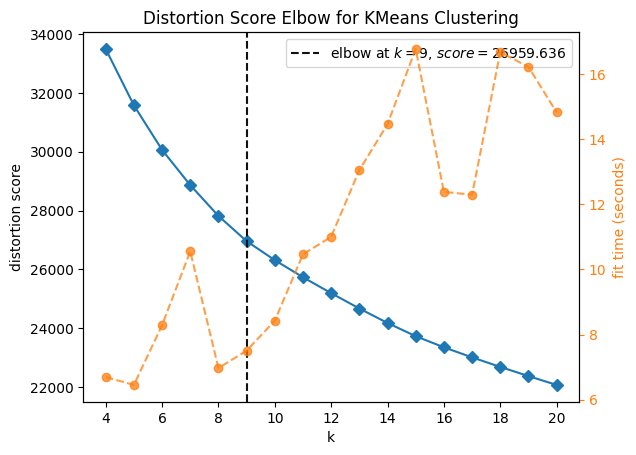

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [82]:
#determine optimum k-clusters using yellowbrick visualizer

kmeans = KMeans(init = 'k-means++', n_init = 10, max_iter = 300, random_state = 0)
visualizer = KElbowVisualizer(kmeans, k = (4,21))

visualizer.fit(np.array(normalized_fc_doc_vectors))
visualizer.show()

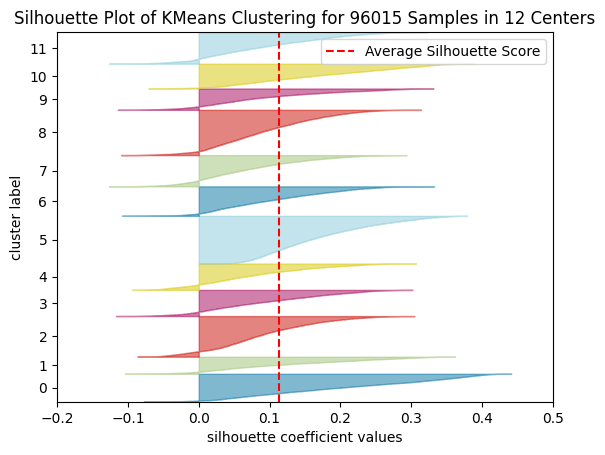

<Axes: title={'center': 'Silhouette Plot of KMeans Clustering for 96015 Samples in 12 Centers'}, xlabel='silhouette coefficient values', ylabel='cluster label'>

In [85]:
sil_visualizer = SilhouetteVisualizer(
                    KMeans(n_clusters=12, #visualizer.elbow_value_, 
                           init="k-means++", max_iter=300, n_init=10, random_state = 12), 
                    colors = 'yellowbrick')

sil_visualizer.fit (np.array(normalized_fc_doc_vectors))
sil_visualizer.show()

In [134]:
#document clustering with optimal k value from visualizer
true_k = 12 #visualizer.elbow_value_

kmeans = KMeans(n_clusters=true_k, init="k-means++", max_iter=300, n_init=10, random_state = 12)

kmeans.fit(np.array(normalized_fc_doc_vectors))

KMeans(n_clusters=12, n_init=10, random_state=12)

In [135]:
#print out top 10 words occurring in documents in each cluster

# Assign each document to a cluster
clusters = kmeans.labels_

# For each cluster
for i in range(true_k):
    print(f"Cluster {i}:")

    # Find all the documents that belong to this cluster
    docs_in_cluster = [doc for doc, cluster in zip(data['updated_tokens'].values, clusters) if cluster == i]

    # Count the frequency of each word in these documents
    word_freq = Counter(word for doc in docs_in_cluster for word in doc)

    # Print the 10 words with the highest frequency
    for word, freq in word_freq.most_common(10):
        print(f"    {word}")


Cluster 0:
    drive
    lane
    road
    driver
    speed
    fast
    traffic
    fine
    stop
    light
Cluster 1:
    test
    case
    covid
    mask
    vaccine
    virus
    safe
    take
    positive
    travel
Cluster 2:
    read
    child
    law
    learn
    religion
    human
    parent
    racist
    muslim
    movie
Cluster 3:
    mall
    area
    building
    park
    parking
    walk
    near
    metro
    visit
    sharjah
Cluster 4:
    water
    hot
    cool
    summer
    cat
    heat
    night
    cold
    rain
    air
Cluster 5:
    take
    play
    call
    meet
    movie
    experience
    read
    real
    stop
    date
Cluster 6:
    price
    buy
    sell
    cost
    rent
    cheap
    market
    property
    expensive
    real
Cluster 7:
    indian
    culture
    arab
    arabic
    english
    local
    expat
    india
    language
    middle
Cluster 8:
    salary
    visa
    business
    experience
    offer
    government
    passport
    low
    

In [136]:
# Reduce the dimensionality of the document vectors to 2D
import plotly.express as px

pca = PCA(n_components=2)
doc_vectors_2d = pca.fit_transform(normalized_fc_doc_vectors)
docs = data['updated_tokens'].copy()

In [126]:
from sklearn.manifold import TSNE

# Apply t-SNE to reduce dimensionality to 2D
tsne = TSNE(n_components=2, learning_rate = 50)
doc_vectors_2d = tsne.fit_transform(normalized_fc_doc_vectors)

In [137]:
doc_vectors_2d[1][1]

-0.028051786

In [138]:
print(len(doc_vectors_2d))
print(len(clusters))
print(len(docs))


96015
96015
96015


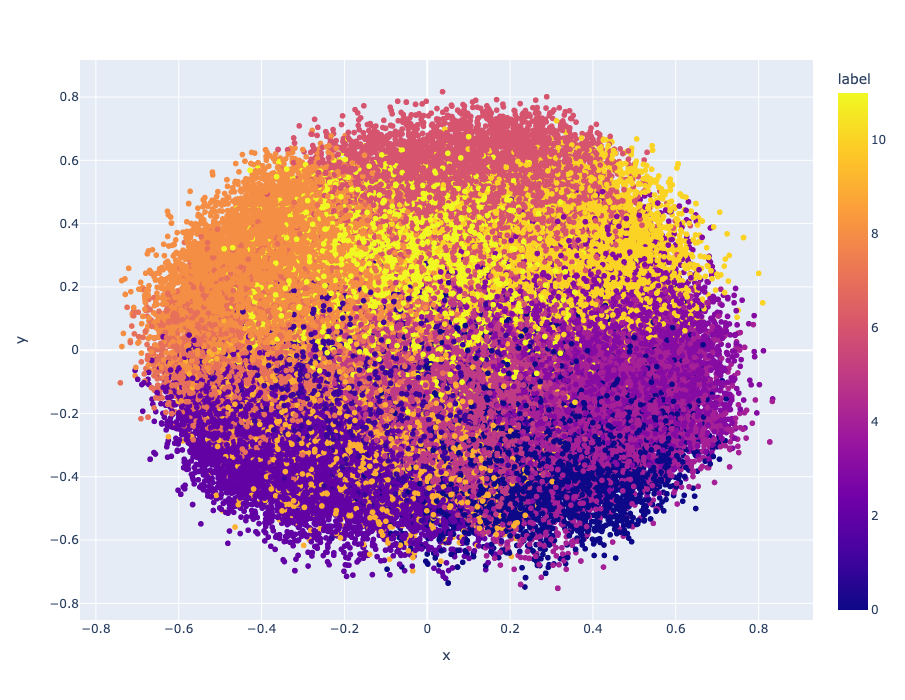

In [139]:
# Create a DataFrame with the 2D vectors and the labels
df = pd.DataFrame({
                'x':doc_vectors_2d[:, 0],
                'y':doc_vectors_2d[:, 1],
                'label': clusters,
                'docs': docs})


# Create the scatter plot
fig = px.scatter(df, x='x', y='y', 
                 color='label',
                 hover_data = ['docs']
                )
fig.update_layout(width = 800, height = 700)
fig.show()


### word clustering --- disregard

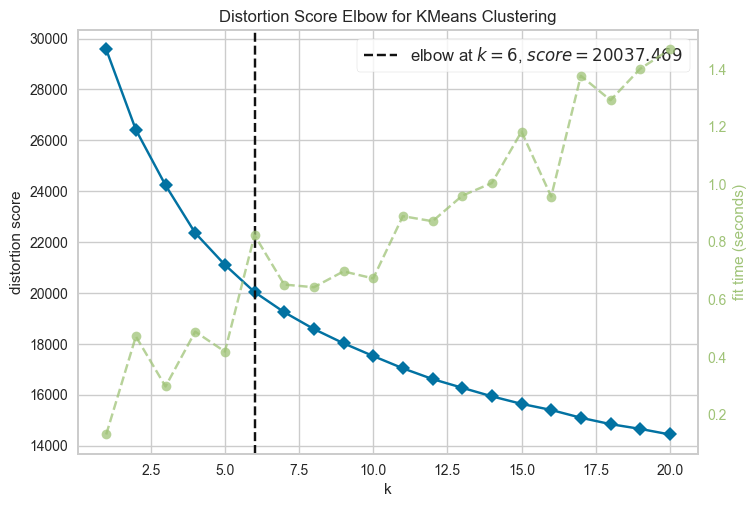

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [29]:
#determine optimum k-clusters using yellowbrick visualizer

fc_vectors= fc_model.wv.vectors #2d word vectors for clustering


kmeans = KMeans(init = 'k-means++', n_init = 10, max_iter = 300, random_state = 0)
visualizer = KElbowVisualizer(kmeans, k = (1,21))

visualizer.fit(fc_vectors)
visualizer.show()


In [51]:
optimal_k = 14 #visualizer.elbow_value_

# Kmeans clustering
kmeans = KMeans(n_clusters=optimal_k, init='k-means++', n_init=10, random_state=0)
kmeans.fit(fc_vectors)

# cluster label for each word
labels = kmeans.labels_

# map word to cluster label
word_to_cluster = {word: cluster for word, cluster in zip(fc_model.wv.index_to_key, labels)}

# print 10 words in each cluster
for i in range(optimal_k):
    words_in_cluster = [word for word, cluster in word_to_cluster.items() if cluster == i]
    print(f"Cluster {i}: {words_in_cluster[:10]}")

Cluster 0: ['play', 'type', 'past', 'party', 'actual', 'lmao', 'suppose', 'trust', 'anymore', 'interesting']
Cluster 1: ['small', 'couple', 'date', 'enjoy', 'recently', 'super', 'plus', 'cut', 'game', 'recommend']
Cluster 2: ['real', 'deal', 'meet', 'course', 'system', 'community', 'single', 'assume', 'rest', 'set']
Cluster 3: ['buy', 'price', 'service', 'cost', 'sell', 'cheap', 'market', 'bank', 'charge', 'rent']
Cluster 4: ['call', 'card', 'report', 'notice', 'emirate', 'website', 'require', 'contact', 'office', 'remove']
Cluster 5: ['read', 'law', 'learn', 'rule', 'parent', 'social', 'child', 'human', 'movie', 'complain']
Cluster 6: ['experience', 'business', 'family', 'visa', 'salary', 'offer', 'low', 'government', 'school', 'base']
Cluster 7: ['drive', 'fine', 'stop', 'police', 'lane', 'road', 'driver', 'fast', 'speed', 'turn']
Cluster 8: ['case', 'safe', 'test', 'covid', 'public', 'travel', 'mask', 'risk', 'health', 'daily']
Cluster 9: ['food', 'water', 'order', 'restaurant', 'de

In [52]:
# Reduce the dimensionality of the document vectors to 2D
import plotly.express as px

pca = PCA(n_components=2)
word_vectors_2d = pca.fit_transform(fc_vectors)
words = fc_model.wv.index_to_key

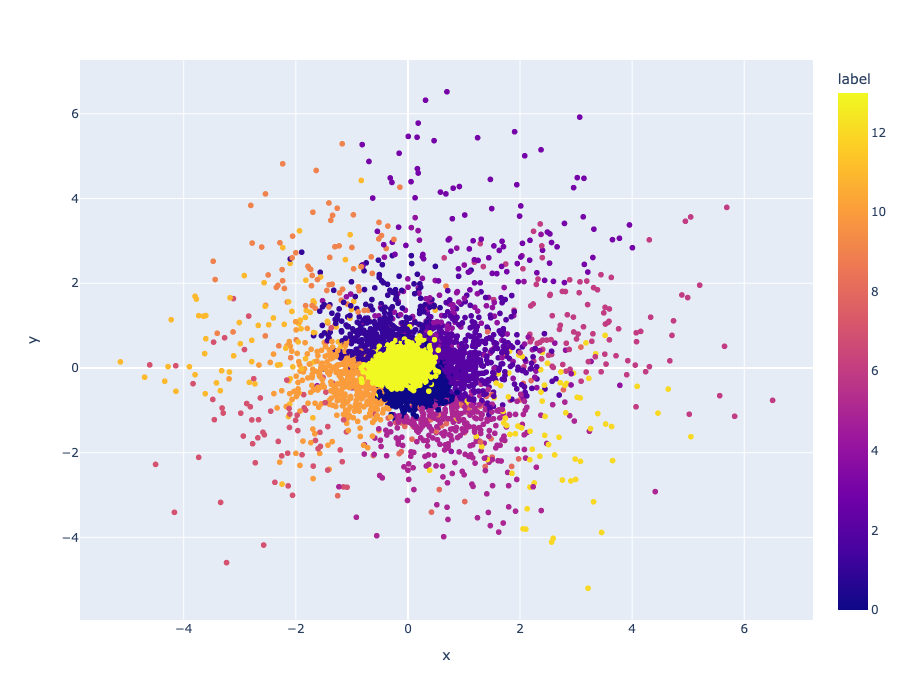

In [53]:
# Create a DataFrame with the 2D vectors and the labels
df = pd.DataFrame({
                'x':word_vectors_2d[:, 0],
                'y':word_vectors_2d[:, 1],
                'label': labels,
                'word': words})


# Create the scatter plot
fig = px.scatter(df, x='x', y='y', 
                 color='label',
                 hover_data = ['word']
                )
fig.update_layout(width = 800, height = 700)
fig.show()


In [95]:
#number of documents per cluster
cluster_df = data.copy()
cluster_df['labels'] = clusters

doc_per_cluster = cluster_df.groupby('labels').size()

doc_per_cluster

labels
0      5543
1      5300
2      5389
3      6002
4      4159
5      6489
6      1508
7     26605
8      2182
9     16436
10     5232
11    11170
dtype: int64

In [96]:
mask = cluster_df['labels'] == 7
cluster_df[mask].sample(n=5)

,text_type,ID,year,long_text,clean_text,word_count,tokens,updated_tokens,labels
30421,comment,dyd95o5,2018,"im not one of those ""scumbags"" that you speak ...",scumbags speak way wake early morning enjoy mo...,62,"[scumbag, speak, way, wake, early, morning, en...","[scumbag, wake, early, morning, enjoy, morning...",7
62967,comment,ilv7zhs,2022,This.. all these clowns scared of being tracke...,clowns scared tracked nobodies care track,6,"[clown, scare, track, nobody, care, track]","[clown, scare, track, track]",7
35607,comment,hemgls6,2021,As someone who works in retail. I’d like to ap...,works retail like apologize behavior stay near...,42,"[work, retail, like, apologize, behavior, stay...","[retail, apologize, behavior, near, customer, ...",7
9453,comment,i0va9s7,2022,"That's a laughing dove, you uncultured swine",laughing dove uncultured swine,4,"[laugh, dove, uncultured, swine]","[laugh, dove]",7
93396,submission,12lwsae,2023,What is on fire? I saw this leaving festival c...,fire saw leaving festival city smoke visible m...,10,"[fire, see, leave, festival, city, smoke, visi...","[fire, festival, smoke, visible, mile]",7


In [101]:
# Count the number of rows where the length of 'tokens' is less than 3
count = data[data['updated_tokens'].apply(lambda x: len(x) < 3)].shape[0]
indx = data[data['updated_tokens'].apply(lambda x: len(x) < 3)].index
print(f"Number of rows with less than 3 tokens: {count}")
print (indx[:5])

Number of rows with less than 3 tokens: 22929
Index([0, 4, 5, 6, 7], dtype='int64')
